In [1]:
using DataFrames, GraphPlot, Impute, Plots, Colors

include("funciones_de_red.jl")
include("objetos.jl")
include("dinamica_conductores.jl")
include("animaciones.jl")

plot_digraph (generic function with 1 method)

# Sin diagonales

In [2]:
k = 5
m = k^2
SquareNet, position_array, dist_matrix = SquareDiGraph(k, doble_sentido=true);

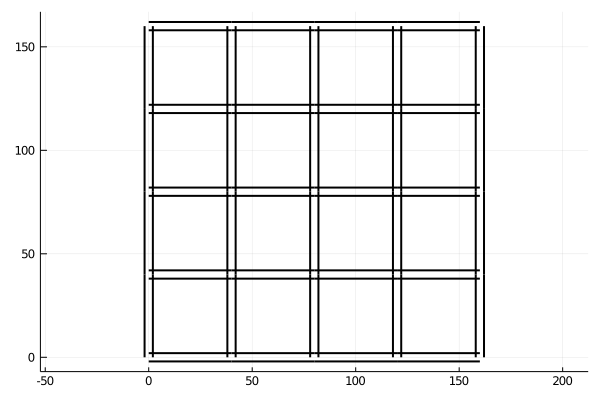

In [3]:
plot_digraph(SquareNet, position_array, separated_edges=true)

In [4]:
city_matrix = zeros(m,m,4);
f = x -> [speed(i,j,x) for i in 1:length(x),j in 1:length(x)]
city_matrix[:,:,1] = dist_matrix./f(position_array);
city_matrix[:,:,2] = dist_matrix.*3/5;
city_matrix[:,:,4] = BPR.(city_matrix[:,:,1], city_matrix[:,:,3],city_matrix[:,:,2]);
red_cuadrada=network(SquareNet,position_array,city_matrix);

In [5]:
function generate_auto(m,t,red)
    o = rand(1:m)
    d = collect(1:m)
    splice!(d,o)
    d = d[rand(1:end)]
    return auto(o,d,t,0.25,red)
end

autos = [generate_auto(m,t,red_cuadrada) for t in collect(0.5:0.321:150.)];

In [6]:
times, vels = simulacion!(0.,red_cuadrada, autos);

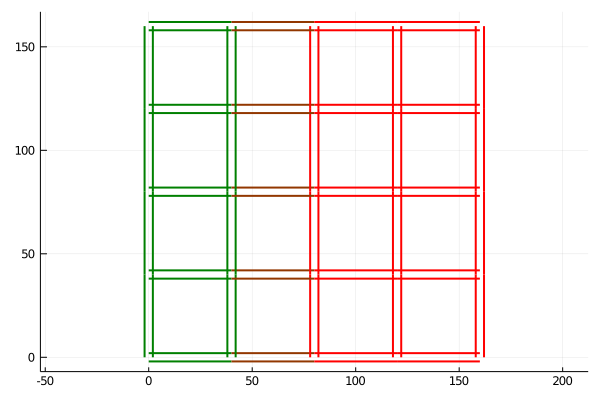

In [7]:
plot_digraph(SquareNet,position_array, attribute_matrix=vels,separated_edges=true)

In [8]:
new_times, x_out, y_out, x_dest, y_dest = continuos_time!(times,autos);

In [9]:
c1 = colorant"red"
c2 = colorant"blue"
carcolors = range(c1, stop=c2, length=length(autos))

In [10]:
to_follow = rand(1:length(autos),5)

5-element Array{Int64,1}:
 170
 186
  54
 128
 166

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaynodiag-big-5followed.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaynodiag-big-5followed.gif")
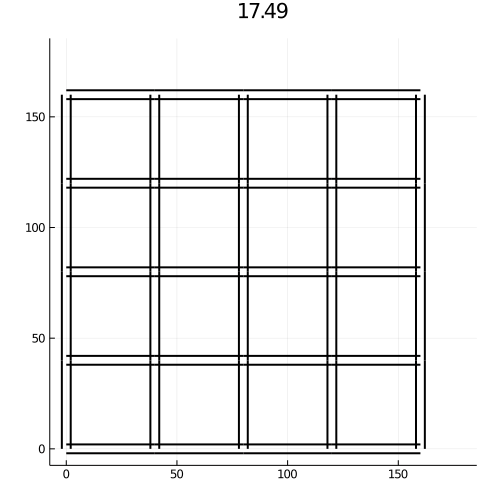

In [11]:
t1 = findall(x -> (x in round.(autos[minimum(to_follow)].ts,digits=2)),new_times)[1]
t2 = findall(x -> (x in round.(autos[maximum(to_follow)].llego,digits=2)),new_times)[end]
anim = @animate for i in t1-2:10:t2+2
    x = [element[i] for element in x_out[to_follow]]
    y = [element[i] for element in y_out[to_follow]]
    x2 = [element[i] for element in x_dest[to_follow]]
    y2 = [element[i] for element in y_dest[to_follow]]
    fig = plot_digraph(SquareNet, position_array,separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors[to_follow], aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "gifs/firstdaynodiag-big-5followed.gif", fps = 50)

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaynodiag-big.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaynodiag-big.gif")
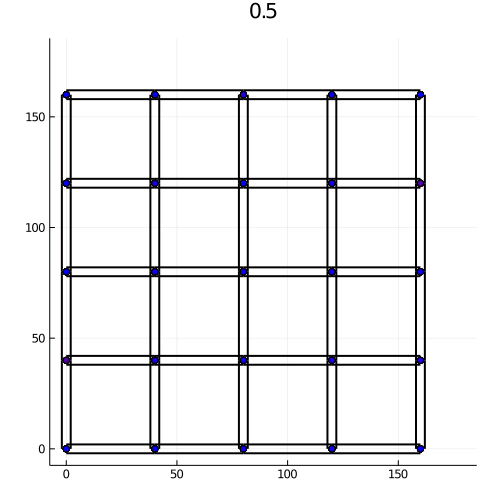

In [12]:
anim = @animate for i in 1:10:length(new_times)
    x = [element[i] for element in x_out]
    y = [element[i] for element in y_out]
    x2 = [element[i] for element in x_dest]
    y2 = [element[i] for element in y_dest]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors, aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "gifs/firstdaynodiag-big.gif", fps = 50)

In [13]:
restart(autos, red_cuadrada)
times, vels = simulacion!(0.,red_cuadrada, autos);
new_times, x_out, y_out, x_dest, y_dest = continuos_time!(times,autos);

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 19 => 18, Edge 18 => 23] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 19 => 24, Edge 24 => 23]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 23 => 18, Edge 18 => 13, Edge 13 => 14] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 23 => 24, Edge 24 => 19, Edge 19 => 14]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 18 => 17, Edge 17 => 12, Edge 12 => 7, Edge 7 => 2, Edge 2 => 1] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 18 => 17, Edge 17 => 16, Edge 16 => 11, Edge 11 => 6, Edge 6 => 1]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 20 => 19, Edge 19 => 18, Edge 18 => 17, Edge 17 => 12, Edge 12 => 11] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 20 => 19, Edge 19 => 18, Edge 18 => 17, Edge 17 => 16, Edge 16 => 11]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 1 => 2, Edge 2 => 7] to LightGraphs.SimpleGraphs.Simpl

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 23 => 22, Edge 22 => 17, Edge 17 => 12, Edge 12 => 7, Edge 7 => 2, Edge 2 => 1] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 23 => 22, Edge 22 => 21, Edge 21 => 16, Edge 16 => 11, Edge 11 => 6, Edge 6 => 1]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 25 => 24, Edge 24 => 23, Edge 23 => 22, Edge 22 => 17, Edge 17 => 16] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 25 => 24, Edge 24 => 23, Edge 23 => 22, Edge 22 => 21, Edge 21 => 16]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 4 => 9, Edge 9 => 8, Edge 8 => 13] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 4 => 9, Edge 9 => 14, Edge 14 => 13]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 14 => 13, Edge 13 => 18] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 14 => 19, Edge 19 => 18]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 23 => 22, Edge 22 => 17, Edge 17

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 7 => 12, Edge 12 => 17, Edge 17 => 16, Edge 16 => 21] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 7 => 6, Edge 6 => 11, Edge 11 => 16, Edge 16 => 21]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 4 => 3, Edge 3 => 2, Edge 2 => 1, Edge 1 => 6] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 4 => 3, Edge 3 => 2, Edge 2 => 7, Edge 7 => 6]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 18 => 19, Edge 19 => 20, Edge 20 => 15] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 18 => 13, Edge 13 => 14, Edge 14 => 15]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 10 => 9, Edge 9 => 8, Edge 8 => 7, Edge 7 => 6, Edge 6 => 11] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 10 => 9, Edge 9 => 8, Edge 8 => 7, Edge 7 => 12, Edge 12 => 11]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 25 => 20, Edge 20 => 19, Edge 19 => 14] to LightGr

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 1 => 6, Edge 6 => 11, Edge 11 => 16, Edge 16 => 21, Edge 21 => 22] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 1 => 2, Edge 2 => 7, Edge 7 => 12, Edge 12 => 17, Edge 17 => 22]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 21 => 16, Edge 16 => 17, Edge 17 => 12] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 21 => 16, Edge 16 => 11, Edge 11 => 12]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 8 => 7, Edge 7 => 12, Edge 12 => 17, Edge 17 => 22, Edge 22 => 23, Edge 23 => 24] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 8 => 13, Edge 13 => 18, Edge 18 => 19, Edge 19 => 24]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 25 => 24, Edge 24 => 23, Edge 23 => 22, Edge 22 => 17, Edge 17 => 12, Edge 12 => 7, Edge 7 => 8] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 25 => 24, Edge 24 => 23, Edge 23 => 18, Edge 18 => 13, Edge 13 => 8]
a path cha

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/seconddaynodiag-big-5followed.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/seconddaynodiag-big-5followed.gif")
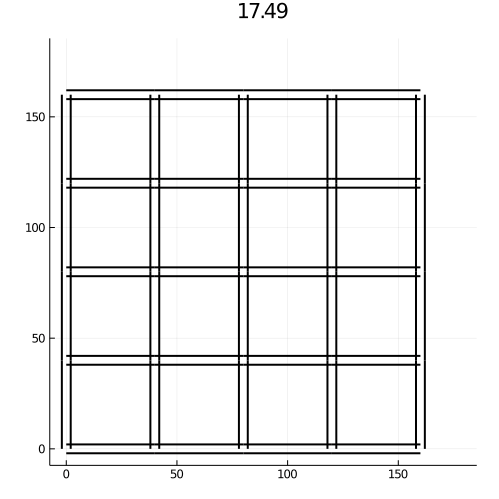

In [14]:
t1 = findall(x -> (x in round.(autos[minimum(to_follow)].ts,digits=2)),new_times)[1]
t2 = findall(x -> (x in round.(autos[maximum(to_follow)].llego,digits=2)),new_times)[end]
anim = @animate for i in t1-2:10:t2+2    
    x = [element[i] for element in x_out[to_follow]]
    y = [element[i] for element in y_out[to_follow]]
    x2 = [element[i] for element in x_dest[to_follow]]
    y2 = [element[i] for element in y_dest[to_follow]]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors[to_follow], aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "gifs/seconddaynodiag-big-5followed.gif", fps = 50)

# Con diagonales

In [19]:
nw,posarr,distm = SquareDiGraph(5, doble_sentido=true)
diag_start = [7.,160.];
pendiente = -pi/5;
nw, posarr, distm, new_positions = add_diagonal!(nw,posarr,diag_start, pendiente, 5.,40.)
SquareNet, position_array, dist_matrix = make_slow_corners(nw,posarr,new_positions);

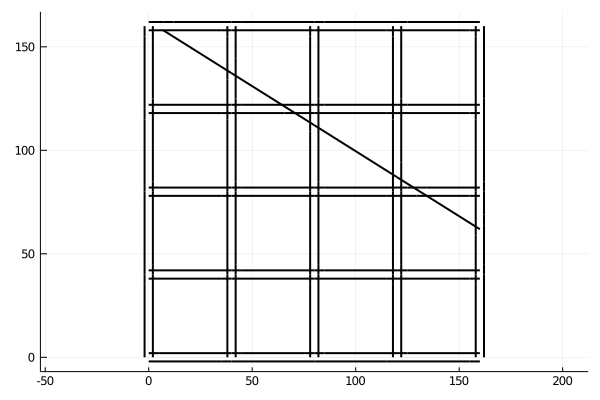

In [20]:
plot_digraph(SquareNet, position_array, separated_edges=true)

In [21]:
j = nv(nw)
city_matrix = zeros(j, j,4);
f = x -> [speed(i,j,x) for i in 1:length(x),j in 1:length(x)]
city_matrix[:,:,1] = dist_matrix./f(position_array);
city_matrix[:,:,2] = max.(dist_matrix.*3/5,ones(j,j).*6);
city_matrix[:,:,4] = BPR.(city_matrix[:,:,1], city_matrix[:,:,3],city_matrix[:,:,2]);
red_cuadrada=network(SquareNet,position_array,city_matrix);

In [22]:
autos = [generate_auto(m,t,red_cuadrada) for t in collect(0.5:0.321:150.)];

In [23]:
times, vels = simulacion!(0.,red_cuadrada, autos);

In [24]:
new_times, x_out, y_out, x_dest, y_dest = continuos_time!(times,autos);

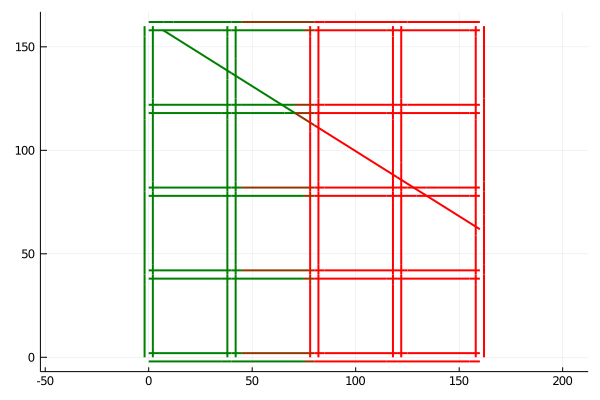

In [25]:
plot_digraph(SquareNet, position_array, attribute_matrix=vels,separated_edges=true)

In [26]:
to_follow = rand(1:length(autos),5)

5-element Array{Int64,1}:
 293
  89
  71
 269
 430

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaydiag-big-5followed.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaydiag-big-5followed.gif")
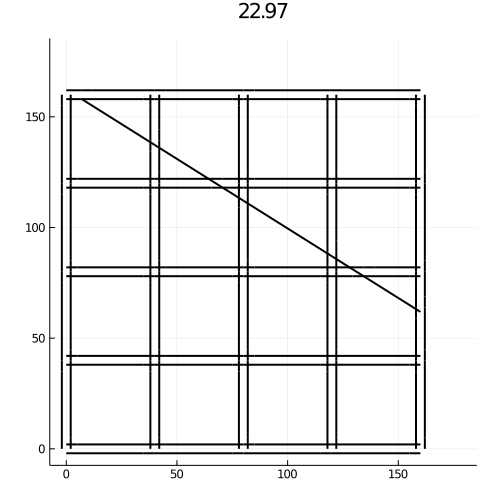

In [27]:
t1 = findall(x -> (x in round.(autos[minimum(to_follow)].ts,digits=2)),new_times)[1]
t2 = findall(x -> (x in round.(autos[maximum(to_follow)].llego,digits=2)),new_times)[1]
anim = @animate for i in t1:10:t2+2        
    x = [element[i] for element in x_out[to_follow]]
    y = [element[i] for element in y_out[to_follow]]
    x2 = [element[i] for element in x_dest[to_follow]]
    y2 = [element[i] for element in y_dest[to_follow]]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors[to_follow], aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "gifs/firstdaydiag-big-5followed.gif", fps = 50)

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaydiag-big.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaydiag-big.gif")
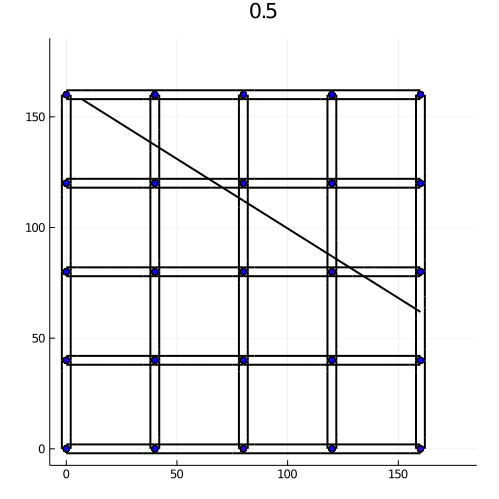

In [28]:
anim = @animate for i in 1:10:length(new_times)
    x = [element[i] for element in x_out]
    y = [element[i] for element in y_out]
    x2 = [element[i] for element in x_dest]
    y2 = [element[i] for element in y_dest]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors, aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "gifs/firstdaydiag-big.gif", fps = 50)

In [29]:
restart(autos, red_cuadrada)
times, vels = simulacion!(0.,red_cuadrada, autos);
new_times, x_out, y_out, x_dest, y_dest = continuos_time!(times,autos);

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 13 => 72, Edge 72 => 12, Edge 12 => 70, Edge 70 => 17, Edge 17 => 85, Edge 85 => 16, Edge 16 => 83, Edge 83 => 21] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 13 => 72, Edge 72 => 12, Edge 12 => 68, Edge 68 => 11, Edge 11 => 66, Edge 66 => 16, Edge 16 => 83, Edge 83 => 21]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 13 => 73, Edge 73 => 14, Edge 14 => 30, Edge 30 => 114, Edge 114 => 19, Edge 19 => 92, Edge 92 => 24, Edge 24 => 106, Edge 106 => 25] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 13 => 74, Edge 74 => 29, Edge 29 => 18, Edge 18 => 88, Edge 88 => 19, Edge 19 => 91, Edge 91 => 20, Edge 20 => 96, Edge 96 => 25]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 8 => 53, Edge 53 => 3, Edge 3 => 39, Edge 39 => 4] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 8 => 55, Edge 55 => 9, Edge 9 => 57, Edge 57 => 4]
a path changed from LightGraphs.SimpleGraphs.Si

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 11 => 65, Edge 65 => 12, Edge 12 => 70, Edge 70 => 17, Edge 17 => 86, Edge 86 => 27, Edge 27 => 111, Edge 111 => 22, Edge 22 => 98, Edge 98 => 23] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 11 => 66, Edge 66 => 16, Edge 16 => 82, Edge 82 => 17, Edge 17 => 86, Edge 86 => 27, Edge 27 => 111, Edge 111 => 22, Edge 22 => 98, Edge 98 => 23]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 7 => 52, Edge 52 => 12, Edge 12 => 70, Edge 70 => 17, Edge 17 => 85, Edge 85 => 16, Edge 16 => 83, Edge 83 => 21] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 7 => 50, Edge 50 => 6, Edge 6 => 48, Edge 48 => 11, Edge 11 => 66, Edge 66 => 16, Edge 16 => 83, Edge 83 => 21]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 19 => 90, Edge 90 => 18, Edge 18 => 28, Edge 28 => 112, Edge 112 => 17, Edge 17 => 85, Edge 85 => 16, Edge 16 => 83, Edge 83 => 21] to LightGraphs.SimpleGraphs.SimpleEdge{Int

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 1 => 34, Edge 34 => 6, Edge 6 => 48, Edge 48 => 11, Edge 11 => 65, Edge 65 => 12, Edge 12 => 70, Edge 70 => 17, Edge 17 => 86, Edge 86 => 27, Edge 27 => 111, Edge 111 => 22, Edge 22 => 98, Edge 98 => 23] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 1 => 34, Edge 34 => 6, Edge 6 => 48, Edge 48 => 11, Edge 11 => 66, Edge 66 => 16, Edge 16 => 82, Edge 82 => 17, Edge 17 => 86, Edge 86 => 27, Edge 27 => 111, Edge 111 => 22, Edge 22 => 98, Edge 98 => 23]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 20 => 95, Edge 95 => 19, Edge 19 => 90, Edge 90 => 18, Edge 18 => 28, Edge 28 => 112, Edge 112 => 17, Edge 17 => 84, Edge 84 => 12, Edge 12 => 68, Edge 68 => 11] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 20 => 95, Edge 95 => 19, Edge 19 => 90, Edge 90 => 18, Edge 18 => 28, Edge 28 => 112, Edge 112 => 17, Edge 17 => 85, Edge 85 => 16, Edge 16 => 81, Edge 81 => 11]
a path changed from LightGraph

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 5 => 45, Edge 45 => 10, Edge 10 => 62, Edge 62 => 9, Edge 9 => 58, Edge 58 => 8, Edge 8 => 54, Edge 54 => 7, Edge 7 => 52, Edge 52 => 12, Edge 12 => 70, Edge 70 => 17, Edge 17 => 86, Edge 86 => 27, Edge 27 => 111, Edge 111 => 22, Edge 22 => 98, Edge 98 => 23] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 5 => 44, Edge 44 => 4, Edge 4 => 43, Edge 43 => 9, Edge 9 => 58, Edge 58 => 8, Edge 8 => 54, Edge 54 => 7, Edge 7 => 52, Edge 52 => 12, Edge 12 => 70, Edge 70 => 17, Edge 17 => 86, Edge 86 => 27, Edge 27 => 111, Edge 111 => 22, Edge 22 => 98, Edge 98 => 23]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 6 => 48, Edge 48 => 11, Edge 11 => 66, Edge 66 => 16, Edge 16 => 82, Edge 82 => 17] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 6 => 47, Edge 47 => 7, Edge 7 => 52, Edge 52 => 12, Edge 12 => 70, Edge 70 => 17]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 13 => 71, 

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 11 => 66, Edge 66 => 16, Edge 16 => 82, Edge 82 => 17, Edge 17 => 86, Edge 86 => 27, Edge 27 => 111, Edge 111 => 22] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 11 => 66, Edge 66 => 16, Edge 16 => 83, Edge 83 => 21, Edge 21 => 26, Edge 26 => 109, Edge 109 => 22]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 3 => 39, Edge 39 => 4, Edge 4 => 43, Edge 43 => 9] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 3 => 40, Edge 40 => 8, Edge 8 => 55, Edge 55 => 9]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 10 => 62, Edge 62 => 9, Edge 9 => 60, Edge 60 => 14, Edge 14 => 30, Edge 30 => 114, Edge 114 => 19, Edge 19 => 90, Edge 90 => 18] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 10 => 63, Edge 63 => 32, Edge 32 => 118, Edge 118 => 15, Edge 15 => 78, Edge 78 => 20, Edge 20 => 95, Edge 95 => 19, Edge 19 => 90, Edge 90 => 18]
a path changed from LightGraphs.SimpleGraphs.

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 2 => 37, Edge 37 => 7, Edge 7 => 52, Edge 52 => 12, Edge 12 => 68, Edge 68 => 11, Edge 11 => 66, Edge 66 => 16] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 2 => 35, Edge 35 => 1, Edge 1 => 34, Edge 34 => 6, Edge 6 => 48, Edge 48 => 11, Edge 11 => 66, Edge 66 => 16]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 8 => 55, Edge 55 => 9, Edge 9 => 60, Edge 60 => 14, Edge 14 => 77, Edge 77 => 31, Edge 31 => 116, Edge 116 => 15, Edge 15 => 78, Edge 78 => 20] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 8 => 56, Edge 56 => 13, Edge 13 => 74, Edge 74 => 29, Edge 29 => 18, Edge 18 => 88, Edge 88 => 19, Edge 19 => 91, Edge 91 => 20]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 11 => 64, Edge 64 => 6, Edge 6 => 47, Edge 47 => 7] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 11 => 65, Edge 65 => 12, Edge 12 => 67, Edge 67 => 7]
a path changed from LightGraphs.SimpleGrap

a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 8 => 53, Edge 53 => 3, Edge 3 => 39, Edge 39 => 4] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 8 => 55, Edge 55 => 9, Edge 9 => 57, Edge 57 => 4]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 19 => 90, Edge 90 => 18, Edge 18 => 28, Edge 28 => 112, Edge 112 => 17, Edge 17 => 84, Edge 84 => 12, Edge 12 => 68, Edge 68 => 11] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 19 => 90, Edge 90 => 18, Edge 18 => 28, Edge 28 => 112, Edge 112 => 17, Edge 17 => 85, Edge 85 => 16, Edge 16 => 81, Edge 81 => 11]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 1 => 33, Edge 33 => 2, Edge 2 => 37, Edge 37 => 7, Edge 7 => 52, Edge 52 => 12, Edge 12 => 69, Edge 69 => 13] to LightGraphs.SimpleGraphs.SimpleEdge{Int64}[Edge 1 => 34, Edge 34 => 6, Edge 6 => 47, Edge 47 => 7, Edge 7 => 52, Edge 52 => 12, Edge 12 => 69, Edge 69 => 13]
a path changed from LightGraphs.SimpleGraphs.SimpleEdge{I

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/seconddaydiag-big-5followed.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/seconddaydiag-big-5followed.gif")
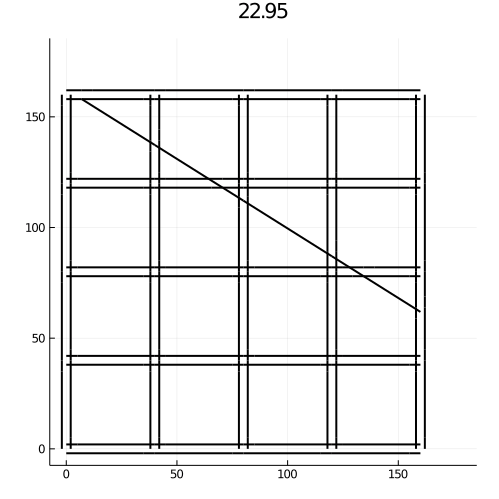

In [30]:
t1 = findall(x -> (x in round.(autos[minimum(to_follow)].ts,digits=2)),new_times)[1]
t2 = findall(x -> (x in round.(autos[maximum(to_follow)].llego,digits=2)),new_times)[end]
anim = @animate for i in t1-2:10:t2+2    
    x = [element[i] for element in x_out[to_follow]]
    y = [element[i] for element in y_out[to_follow]]
    x2 = [element[i] for element in x_dest[to_follow]]
    y2 = [element[i] for element in y_dest[to_follow]]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors[to_follow], aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "gifs/seconddaydiag-big-5followed.gif", fps = 50)

# Para la animación
- Segun la dirección de la arista y los autos moverlos un poco. <input type="checkbox" checked>
- Que los autos aparezcan cuando van a salir. <input type="checkbox" checked>
- Graficar la velocidad promedio en la arista durante la simulación. <input type="checkbox" checked>
- Quitar de la matriz para graficar las aristas que no están realmente <input type="checkbox" checked>
- Corregir el esquema de colores <input type="checkbox" checked>
- Colorear de verde a los que ya llegaron a su destino <input type="checkbox" checked>
- Refinar los tiempos para que todos alcancen a llegar <input type="checkbox" checked>


# Para simulación
- Pruebas de tiempo de la simulación para distintos tamaños de red y distinto número de autos (elapse).
    - Primero mantener constante el numero de autos y crecer la red hasta 100x100 <input type="checkbox" checked>
    - Con la red de 100x100 empezar a aumentar el número de autos <input type="checkbox" checked>
- 100x100 es razonable, ¿Cómo crece el tiempo conforme hay más autos? hasta ~200 más o menos. <input type="checkbox">
- Calles alternadas y 1 carril, quizás la longitud de la calle tenga que reuducirse también. <input type="checkbox">
- Simulación de 100x100 con 80k autos aprox. <input type="checkbox">

__________________________________________________________________________

# Mediciones
- Velocidad promedio respecto al número de días, probarlo con estas pequeñas. <input type="checkbox">
- Experimentar con diferentes combinaciones de diagonales (dobles sentidos, paralelas, con y sin altos)
- Medir los cambios de ruta, elegir algunas rutas y medir si cambia la distancia (comparar si el camino A* es igual antes y después de que pasó el día) cada día que porcentaje de conductores cambia. <input type="checkbox">
- Entre los que cambian cómo saber si regresan al mismo camino. A partir de cierto número de camino. Graficar para cada auto cuál es su periodo. <input type="checkbox">
- Cómo cambia esto respecto a la distribución de $h$ <input type="checkbox">
- Cómo cambia respecto a la densidad

# Recomendación
- instalar StatsBase